In [1]:
# import anything you need
import numpy as np
import pandas as pd
import math as m
import matplotlib.pyplot as plt

In [2]:
# define class
class points:
    x, y = 0, 0
    def __init__(self, pa_x, pa_y):
        self.x = pa_x
        self.y = pa_y
    def dist(self, points2):
        buf = (points2.x - self.x)**2 + (points2.y - self.y)**2
        return( m.sqrt(buf) )
    def pt(self):
        print("x: %f  y: %f" % (self.x, self.y))

In [3]:
# define class
class center(points):
    pointset =  []
    def __init__(self, min_x = 0, max_x = 8, min_y = 0, max_y = 4):
        self.x = np.random.uniform(low = min_x, high = max_x, size = 1)
        self.y = np.random.uniform(low = min_y, high = max_y, size = 1)
        
    def sse(self):
        buf = 0 
        for i in self.pointset:
            buf = buf + ( self.dist(i) )**2
        return(buf)
    
    def adjust(self):
        xbuf, ybuf= [], []
        if(len(self.pointset) >0 ):
            for i in self.pointset:
                xbuf = np.append(xbuf, i.x)
                ybuf = np.append(ybuf, i.y)
            self.x, self.y = np.mean(xbuf), np.mean(ybuf)

In [4]:
# define class
class pointset():
    pt_set = []
    
    def draw(self):
        buf_x , buf_y = [], []
        for i in self.pt_set:
            buf_x = np.append(buf_x, i.x)
            buf_y = np.append(buf_y, i.y)
        plt.scatter(buf_x, buf_y)

In [5]:
# define class
class centerSet():
    pt_set = []
    
    def giveCenter(self, k):
        self.pt_set = []
        for i in range(0, k):
            c = center()
            self.pt_set = np.append(self.pt_set, c)

    def drawone(self, cp, index = 0, color = "0", label = "point", marker = "o"):
        buf_x, buf_y = [], []
        for i in cp.pointset:
            buf_x = np.append(buf_x, i.x)
            buf_y = np.append(buf_y, i.y)
        if( label == "point" ):
            label = "Group %d" % (index+1)
        plt.scatter(buf_x, buf_y, c = color, label = label, marker = marker)         
    
    def draw(self):
        setcolor = np.arange(1, self.pt_set.size + 1)/(self.pt_set.size + 2)
        setcolor = setcolor.astype(str)
        index = 0
        for i in self.pt_set:
            self.drawone(i, index, setcolor[index])
            index = index + 1
            
        buf_x, buf_y = [], []
        for i in self.pt_set:
            buf_x = np.append(buf_x, i.x)
            buf_y = np.append(buf_y, i.y)
        plt.scatter(buf_x, buf_y, label = "Central", marker = "x")     
        plt.legend() 
        plt.show()

In [6]:
# read data 
my_data = pd.read_csv('cdata.csv', sep=',', header=None)
my_data = my_data.values
new_mydata = np.delete(my_data, 0, 0)
x_value = new_mydata[:, 0]
x_value = x_value.astype(np.float)
y_value = new_mydata[:, 1]
y_value = y_value.astype(np.float)
                         
dataset = pointset()
for i in range(0, x_value.size):
    newpoint = points(x_value[i], y_value[i])
    dataset.pt_set = np.append(dataset.pt_set, newpoint)

In [7]:
# define class
class kmean:
    def __init__(self, k, dataset):
        self.dataset = dataset
        self.centers = centerSet()
        self.centers.giveCenter(k)
        
    def arrange(self):
        for i in self.centers.pt_set:
            i.pointset = []
        
        for i in self.dataset.pt_set:
            buf = []
            for j in self.centers.pt_set:
                buf = np.append(buf, i.dist(j))
            index = int(np.where(buf == buf.min())[0])
            cache = self.centers.pt_set[index].pointset
            self.centers.pt_set[index].pointset = np.append(cache, i)
        
    def adjustCenter(self):
        for i in self.centers.pt_set:
            i.adjust()
    
    def times(self, time = 10):
        for i in range(0, time):
            self.arrange()
            self.adjustCenter()
            self.centers.draw()
            plt.show()
            
    def countsse(self):
        buf = 0
        for i in self.centers.pt_set:
            buf = buf + i.sse()
        return(buf)
    

In [8]:
def question1():
    a = kmean(4, dataset)
    a.times()

In [9]:
def question2():
    X = list(range(1, 51))
    Y = []
    for i in range(1, 51):
        a = kmean(i, dataset)
        a.times()
        Y.append(a.countsse())
    plt.plot(X, Y)
    plt.xlabel("Number of k")
    plt.ylabel("SSE")

In [10]:
def question3():
    X = list(range(1, 11))
    Y = []
    for i in range(1, 11):
        a = kmean(10, dataset)
        a.times()
        Y.append(a.countsse())
    plt.bar(X, Y)
    plt.title("Result of ten times randomly pick the initial points")
    plt.xlabel("Fixed k = 10")
    plt.ylabel("SSE")

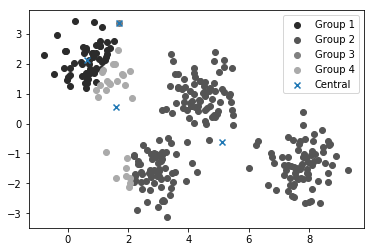

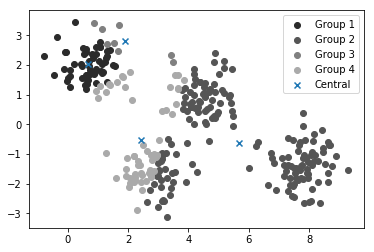

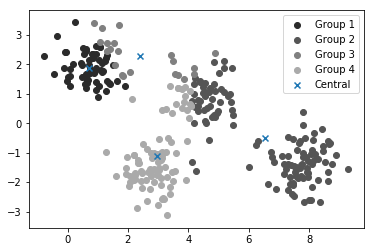

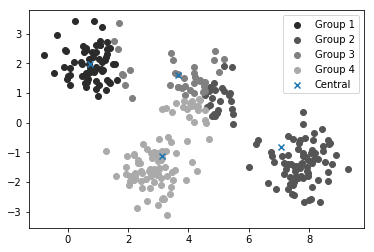

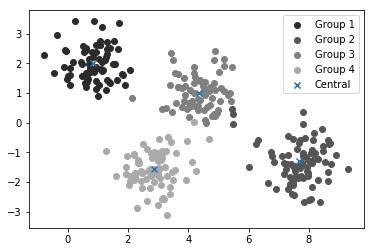

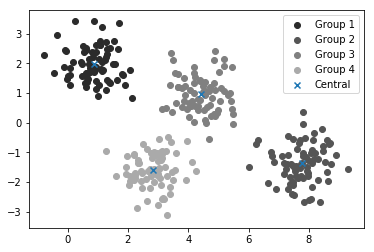

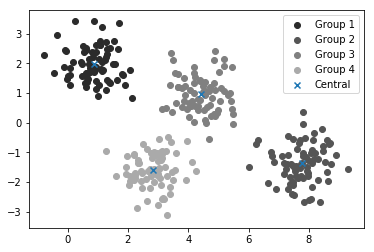

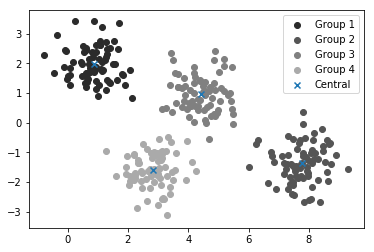

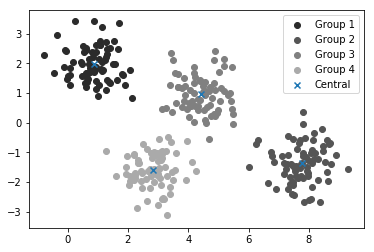

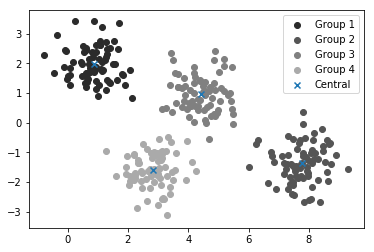

In [11]:
question1()

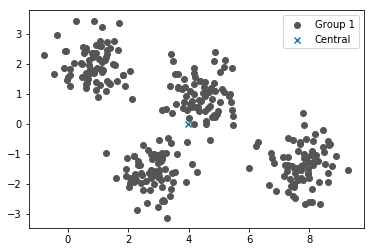

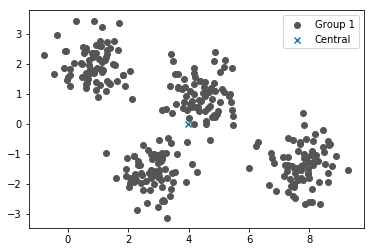

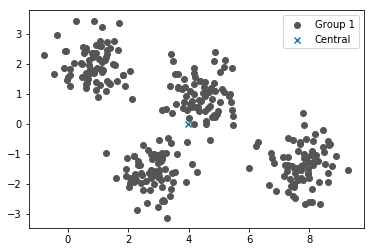

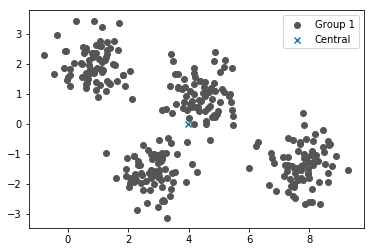

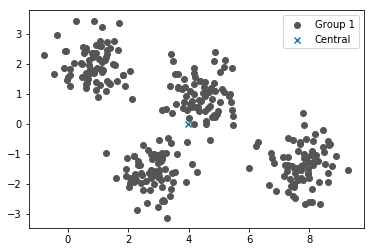

...

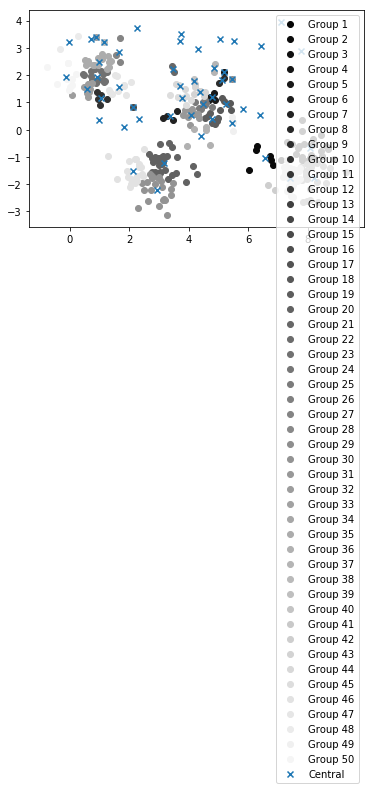

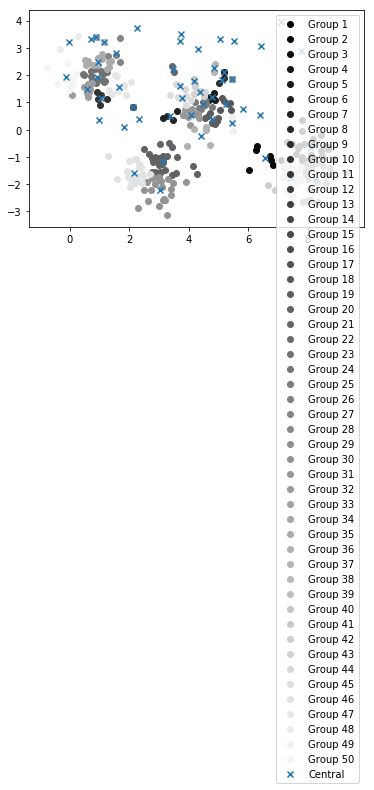

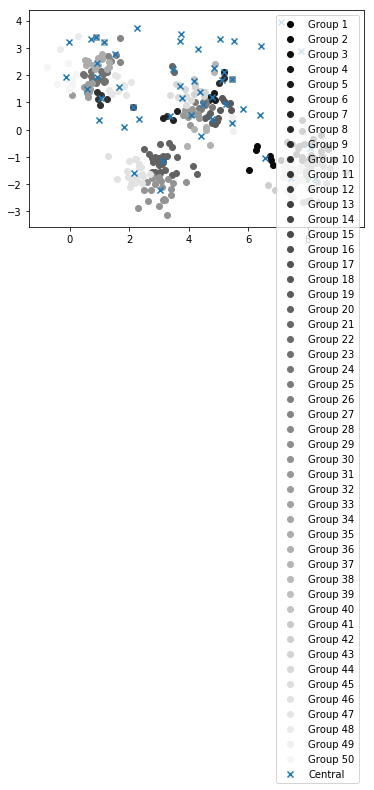

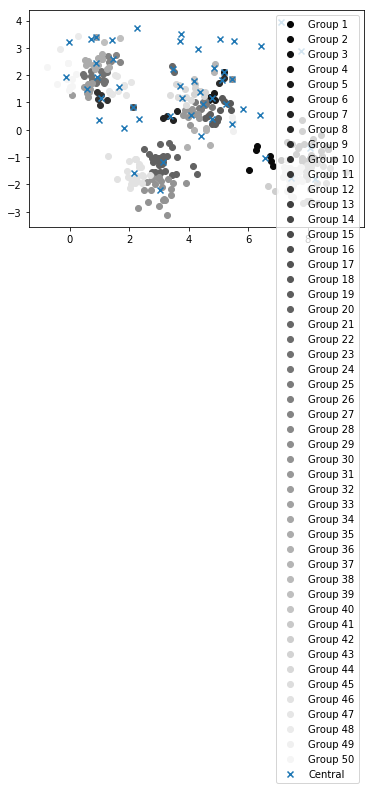

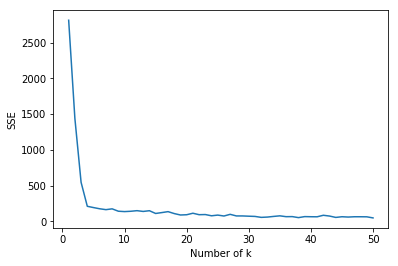

In [12]:
question2()

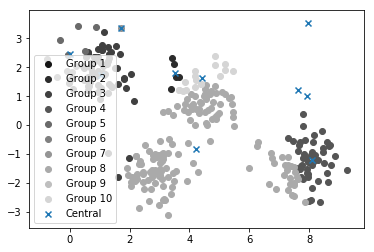

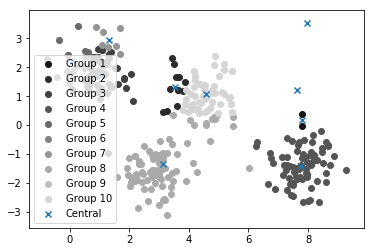

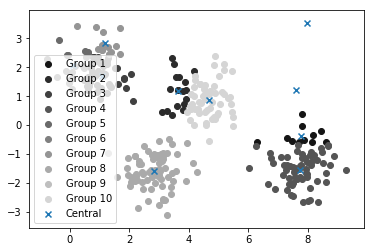

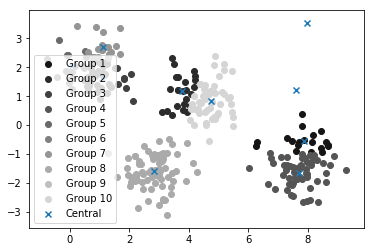

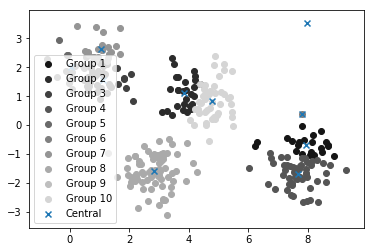

...

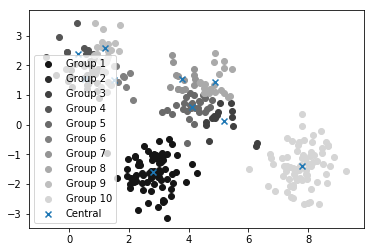

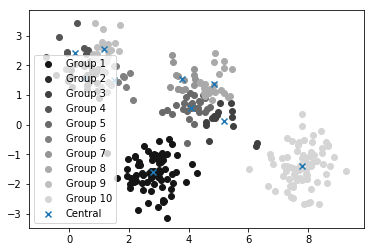

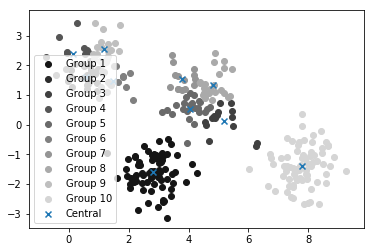

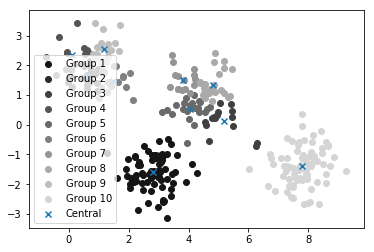

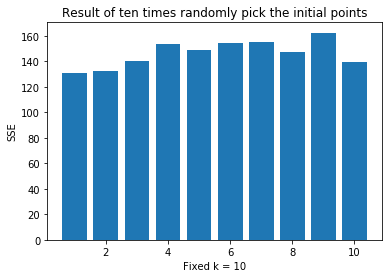

In [13]:
question3()